<a href="https://colab.research.google.com/github/ahmethka/DIP_Assignment/blob/main/assignment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#İhtiyaç duyacağımız paketleri yükleyerek başlıyoruz.
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
import seaborn as sns
import time
sns.set()

Bu adımda genel olarak süreçte kullanacağımız paketleri indirip yüklüyoruz.

In [ ]:
#git adresi üzerinden üzerinde çalışacağımız örnek imajları çekiyoruz.Çalışacağımız klasörün içine giriyoruz.
!git clone https://github.com/hardik0/AI-for-Medicine-Specialization
%cd AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/

Cloning into 'AI-for-Medicine-Specialization'...
remote: Enumerating objects: 1601, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 1601 (delta 9), reused 2 (delta 0), pack-reused 1573 (from 1)
Receiving objects: 100% (1601/1601), 720.36 MiB | 25.01 MiB/s, done.
Resolving deltas: 100% (30/30), done.
Updating files: 100% (1497/1497), done.
/content/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis


github adresi üzerinden erişeceğimiz örnek imajların dosya setini indiriyoruz.  

In [ ]:
#ls komutu ile içinde bulundugumuz directoryi listeliyoruz.
%ls nih/

densenet.hdf5  images_small/  pretrained_model.h5  test.csv  train-small.csv  valid-small.csv


nih klasorunun içindeki objeleri listeliyoruz. Kullanacağımız train-small.csv dosyasının var olduğunu görüyoruz.

In [ ]:
# Nih directorysi icinde bulunan train-small.csv dosyasını train_df objesine atıyoruz.
train_df = pd.read_csv("nih/train-small.csv")
# Train_df objesinin toplam satır ve sütün bilgisini yazdırıyoruz.
print(f'There are {train_df.shape[0]} rows and {train_df.shape[1]} columns in this data frame')
#train_df objesinin ilk 5 satırını yazdırıyoruz.
train_df.head()

There are 1000 rows and 16 columns in this data frame


,Image,Atelectasis,Cardiomegaly,Consolidation,Edema,Effusion,Emphysema,Fibrosis,Hernia,Infiltration,Mass,Nodule,PatientId,Pleural_Thickening,Pneumonia,Pneumothorax
0,00008270_015.png,0,0,0,0,0,0,0,0,0,0,0,8270,0,0,0
1,00029855_001.png,1,0,0,0,1,0,0,0,1,0,0,29855,0,0,0
2,00001297_000.png,0,0,0,0,0,0,0,0,0,0,0,1297,1,0,0
3,00012359_002.png,0,0,0,0,0,0,0,0,0,0,0,12359,0,0,0
4,00017951_001.png,0,0,0,0,0,0,0,0,1,0,0,17951,0,0,0


train-small.csv dosyasını okuyarak train_df objesine atıyoruz. Öncelikle bu dosyada ki toplam satır ve sütün sayısını sonrasında da bu imajların ilk 5 tanesinin genel özelliklerini yazdırıyoruz.

In [ ]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Image               1000 non-null   object
 1   Atelectasis         1000 non-null   int64 
 2   Cardiomegaly        1000 non-null   int64 
 3   Consolidation       1000 non-null   int64 
 4   Edema               1000 non-null   int64 
 5   Effusion            1000 non-null   int64 
 6   Emphysema           1000 non-null   int64 
 7   Fibrosis            1000 non-null   int64 
 8   Hernia              1000 non-null   int64 
 9   Infiltration        1000 non-null   int64 
 10  Mass                1000 non-null   int64 
 11  Nodule              1000 non-null   int64 
 12  PatientId           1000 non-null   int64 
 13  Pleural_Thickening  1000 non-null   int64 
 14  Pneumonia           1000 non-null   int64 
 15  Pneumothorax        1000 non-null   int64 
dtypes: int64(15), object(1)
m

genel olarak train_df objemizin özelliklerini yazdırıyoruz.

In [ ]:
print(f"The total patient ids are {train_df['PatientId'].count()}, from those the unique ids are {train_df['PatientId'].value_counts().shape[0]} ")

The total patient ids are 1000, from those the unique ids are 928 


train_df içerisinde 100 adet patient id bilgisi olduğunu ve bunların 928 adedinin unique oldugu bilgisine bakıp yazdırıyoruz.

In [ ]:
columns = train_df.keys()
columns = list(columns)
print(columns)

['Image', 'Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'PatientId', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


train_df içerisinde ki tüm kolon isimlerini yazdırıyoruz.

In [ ]:
# Image ve PatientId kolonlarını objeden uçuruyoruz.
columns.remove('Image')
columns.remove('PatientId')
# Toplam elimizde kalan kolon sayısını yazdırıyoruz.
print(f"There are {len(columns)} columns of labels for these conditions: {columns}")

There are 14 columns of labels for these conditions: ['Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


train_df objesinde ki 16 kolondan Image ve PatientId isimli kolonları kaldırıyoruz. Geriye 14 kolon bırakıyoruz.

In [ ]:
for column in columns:
    print(f"The class {column} has {train_df[column].sum()} samples")

The class Atelectasis has 106 samples
The class Cardiomegaly has 20 samples
The class Consolidation has 33 samples
The class Edema has 16 samples
The class Effusion has 128 samples
The class Emphysema has 13 samples
The class Fibrosis has 14 samples
The class Hernia has 2 samples
The class Infiltration has 175 samples
The class Mass has 45 samples
The class Nodule has 54 samples
The class Pleural_Thickening has 21 samples
The class Pneumonia has 10 samples
The class Pneumothorax has 38 samples


Geriye kalan 14 kolonda farklı kaç örnek data olduğunun bilgisini yazdırıyoruz.

Display Random Images


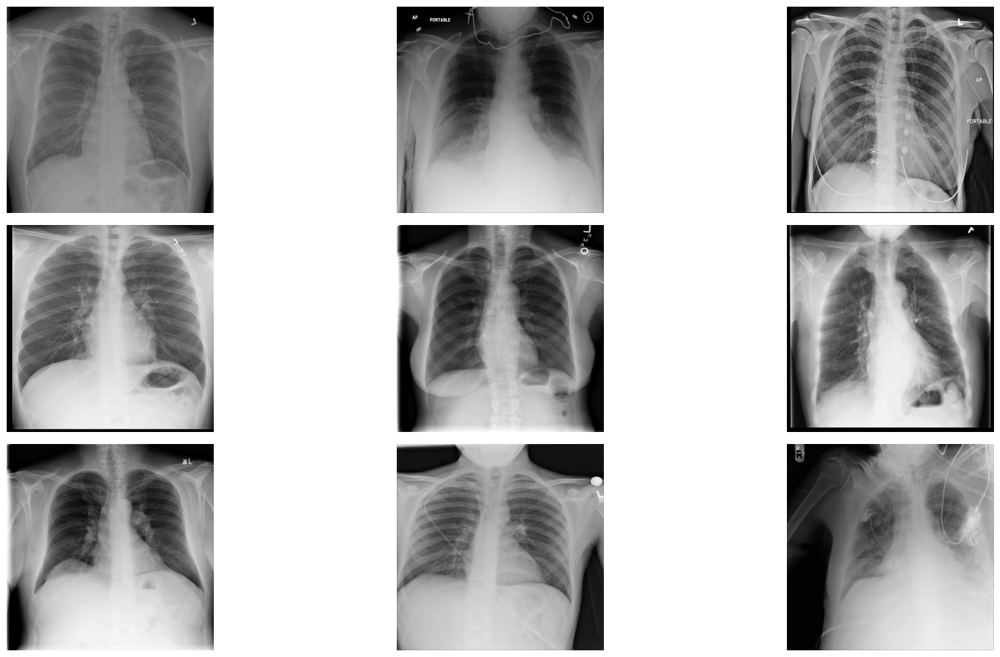

In [ ]:
images = train_df['Image'].values

# 9 random imaj alıyoruz.
random_images = [np.random.choice(images) for i in range(9)]

img_dir = 'nih/images_small/'

print('Display Random Images')

# Plot altında ki imajlara fix boyut veriyoruz.
plt.figure(figsize=(20,10))

# For döngüsü içinde imajları sırası ile yazdırıyoruz.
for i in range(9):
    plt.subplot(3, 3, i + 1)
    img = plt.imread(os.path.join(img_dir, random_images[i]))
    plt.imshow(img, cmap='gray')
    plt.axis('off')

plt.tight_layout()

Örnek veri setinden 9 imaj alıyoruz ve bunu bir diziye yazıyoruz. İmajların boyutunu 20-10 şeklinde ayarlıyoruz. 1 den 9 a kadar bir for döngüsü ile subplotlar halinde imajlarımızı yazdırıyoruz.

The dimensions of the image 1 are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 1.0000 and the minimum is 0.0000
The mean value of the pixels is 0.4327 and the standard deviation is 0.1238
The dimensions of the image 2 are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 1.0000 and the minimum is 0.0000
The mean value of the pixels is 0.4503 and the standard deviation is 0.2612
The dimensions of the image 3 are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 1.0000 and the minimum is 0.0000
The mean value of the pixels is 0.4834 and the standard deviation is 0.2226
The dimensions of the image 4 are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 0.9529 and the minimum is 0.0000
The mean value of the pixels is 0.5656 and the standard deviation is 0.2229
The dimensions of the image 5 are 1024 pixels width 

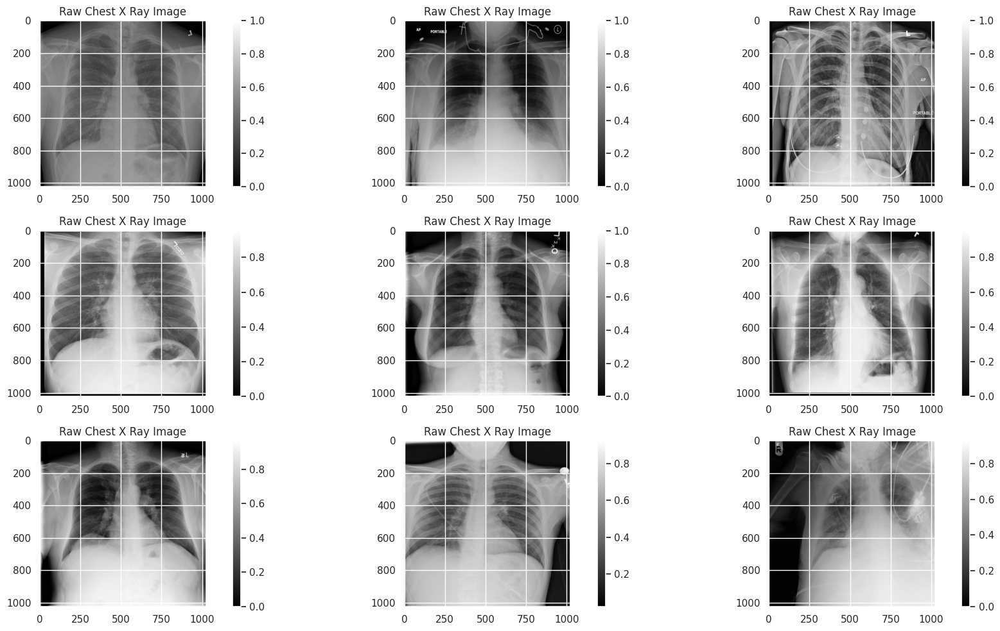

In [ ]:
plt.figure(figsize=(20,10))
raw_image_list=[]
for x in range (9):
  sample_img = random_images[x]
  plt.subplot(3, 3, x + 1)
  raw_image = plt.imread(os.path.join(img_dir, sample_img))
  raw_image_list.insert(x,raw_image) # bu listeyi devam eden kod bloklarında döngü içinde kullanabilmek adına yarattım.
  plt.imshow(raw_image, cmap='gray')
  plt.colorbar()
  plt.tight_layout()
  plt.title('Raw Chest X Ray Image')
  print(f"The dimensions of the image {x + 1} are {raw_image.shape[0]} pixels width and {raw_image.shape[1]} pixels height, one single color channel")
  print(f"The maximum pixel value is {raw_image.max():.4f} and the minimum is {raw_image.min():.4f}")
  print(f"The mean value of the pixels is {raw_image.mean():.4f} and the standard deviation is {raw_image.std():.4f}")

Burada yine imajların boyutlarını 20 ye 10 şeklinde ayarlayarak , 9 imajın raw halini tekrardan yazdırıyoruz.
Bu sefer ek olarak subplotlarda axisi açık bırakıyoruz ve color bar ekliyoruz.
Bununla beraber her imaj için o imaja ait çözünürlük bilgisini , maksimum ve minimum piksel değerleri ile ortalama piksel ve ortalamaya ait standart sapma bilgisini yazdırıyoruz.


<ipython-input-43-e0ae244df320>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(raw_image_list[x].ravel(),


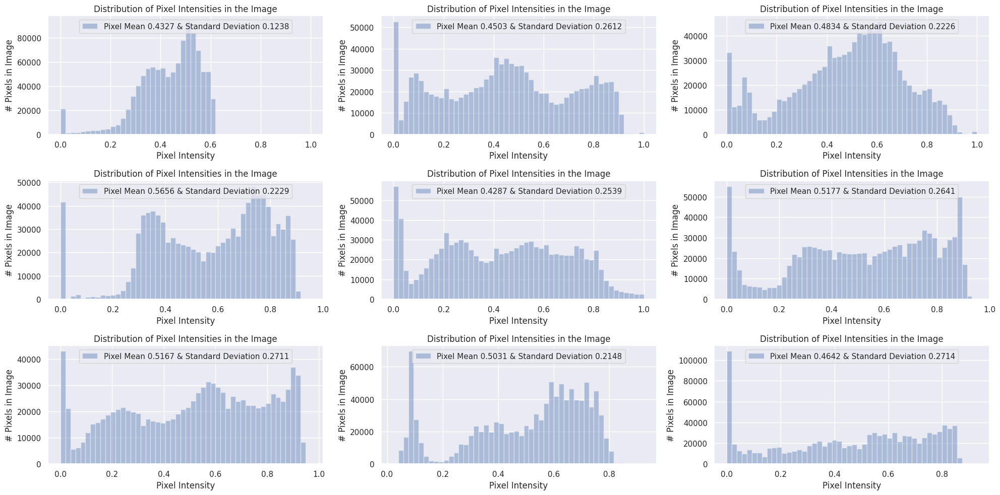

In [ ]:
plt.figure(figsize=(20,10))
for x in range (9):
  plt.subplot(3,3,x+1)
  sns.distplot(raw_image_list[x].ravel(),
             label=f'Pixel Mean {np.mean(raw_image_list[x]):.4f} & Standard Deviation {np.std(raw_image_list[x]):.4f}', kde=False)
  plt.legend(loc='upper center')
  plt.title('Distribution of Pixel Intensities in the Image')
  plt.xlabel('Pixel Intensity')
  plt.ylabel('# Pixels in Image')
plt.tight_layout()



Burada hali hazırda ki 9 imajımızın piksel yogunluklarının dağılımını gösteren özetleri cıkarıyoruz. Bu grafiklerin üstüne bir üst kod bloğunda yazdırmış olduğumuz piksel yoğunlukları ve standart sapmaların da bilgisini ekliyoruz. Grafiklerde dağılım sağa doğru ise görüntüler bizim için daha net ve kaliteli ise piksel yoğunluğunun daha çok sola doğru olduğu imajlarda ise bunun tam tersi durumu görüyoruz.

In [ ]:
pip install numpy

Burada pythonun alt komutu pip - install manageri kullanarak numpy pakedini load ediyoruz.

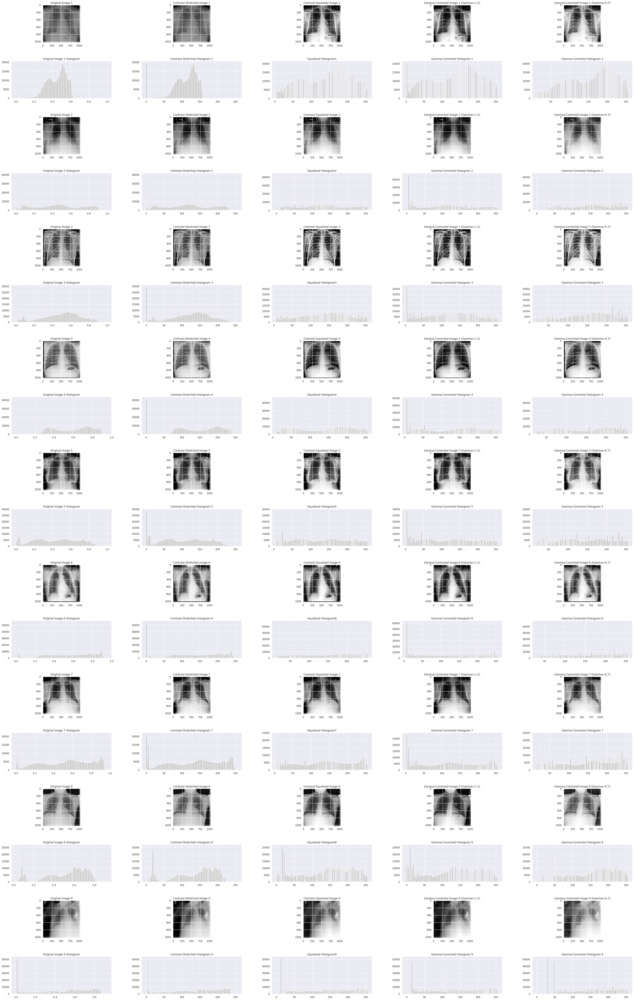

In [ ]:
from skimage import exposure
gamma_corrected_list=[]

#Burada suplot ile istediğim görnütyü elde edemediğim için subplots kullanmaya karar verdim.
#Böyle olunca imajların boyutlarını ve sıralarını daha düzgün biçimde yerleştirebildim.
fig, axes = plt.subplots(18, 5, figsize=(50, 80))
axes = axes.flatten()

for x in range(9):
# Stretching işlemi icin max ve min değerlerini alıyoruz.
  min_val, max_val = raw_image_list[x].min(), raw_image_list[x].max()

# Step 1: Contrast stretching işlemi
  contrast_stretched = (raw_image_list[x] - min_val) / (max_val - min_val)  # Normalize to [0, 1]
  contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # Scale to [0, 255] for visualization

# Histogram eşitleme
  equalized_image = exposure.equalize_hist(contrast_stretched)  # Returns values in [0, 1]
  equalized_image = (equalized_image * 255).astype(np.uint8)    # Scale to [0, 255]


# Step 3: Gamma düzenlemesi
  gamma = 1.2
  gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
  gamma_corrected = gamma_corrected.astype(np.uint8)
  gamma_corrected_list.insert(x,gamma_corrected) # bu listeyi devam eden kod bloklarında döngü içinde kullanabilmek adına yarattım.

  gamma_2 = 0.7  # Yeni gamma denemesi
  gamma_corrected_2 = np.power(equalized_image / 255.0, gamma_2) * 255
  gamma_corrected_2 = gamma_corrected_2.astype(np.uint8)

# burada bir y değeri atamamnın sebebi , subplots altında ki imaj indisi ile orjinal imaj listesinde ki indisi ayırabilmek
  y = 10*x

# Orjinal imaj ve ona ait histogram
  axes[y].imshow(raw_image_list[x], cmap='gray')
  axes[y].set_title(f'Original Image {x+1}')

  axes[y+5].hist(raw_image_list[x].ravel(), bins=256, color='gray')
  axes[y+5].set_title(f"Original Image {x+1} Histogram")

# Contrast stretching sonuçları
  axes[y+1].imshow(contrast_stretched, cmap='gray')
  axes[y+1].set_title(f'Contrast-Stretched Image {x+1}')

  axes[y+6].hist(contrast_stretched.ravel(), bins=256, color='gray')
  axes[y+6].set_title(f"Contrast-Stretched Histogram {x+1}")

# Histogram eşitlemesi sonuçları

  axes[y+2].imshow(equalized_image, cmap='gray')
  axes[y+2].set_title(f'Contrast Equalized Image {x+1}')

  axes[y+7].hist(equalized_image.ravel(), bins=256, color='gray')
  axes[y+7].set_title(f"Equalized Histogram{x+1}")

# Gamma düzenlemesi sonuçları
  axes[y+3].imshow(gamma_corrected, cmap='gray')
  axes[y+3].set_title(f'Gamma-Corrected Image {x+1} (Gamma={gamma})')

  axes[y+8].hist(gamma_corrected.ravel(), bins=256, color='gray')
  axes[y+8].set_title(f"Gamma-Corrected Histogram {x+1}")

# Burada 0.7 lik gamma düzenlemesi sonuçlarını da yazdırıyoruz.
  axes[y+4].imshow(gamma_corrected_2, cmap='gray')
  axes[y+4].set_title(f'Gamma-Corrected Image {x+1} (Gamma={gamma_2})')

  axes[y+9].hist(gamma_corrected_2.ravel(), bins=256, color='gray')
  axes[y+9].set_title(f"Gamma-Corrected Histogram {x+1}")

plt.subplots_adjust(hspace=0.5, wspace=0.3) # subplotlarda ki imajlar arasında spacing bırakıp imajların birbirlerine karışmaması için...
plt.show()

Burada rasgele seçilmiş 9 imajımız için sırası ile contrast stretching , histogram eşitleme ve gamma düzeltme işlemleri uyguluyoruz. Her aksiyon sonrasında imajın o anki halinin (orjinali dahil) histogramını çizdiriyoruz. Contrast stretchingden itibaren yatay ekseni daraltarak 0-256 aralıgına alıyoruz. Orjinal imaj histogramları ile contrast stretching uygulanmış halde ki imaj histogramları yaklaşık olarak benzer iken , histogram eşitleme sonrası grafiğin yatay eksende yayılmaya başladığını görüyoruz. Burada artık imaj üzerinde çözünürlük kalitesini arttırdığımızı görebiliyoruz. Verilen örnekte gamma düzenleme seviyesi 1.2 idi ben , ekstradan örnek olması ve arada ki farkı görebilmek adına 0,7 seviyesinde çalıştırıp onun da sonuçlarını listeledim. (İki gamma düzenlemesi arasında parlaklık seviyeleri yükseldiği için grafikte toplanmaların biraz daha sağa doğru kaydığını görebiliyoruz. )

<ipython-input-46-4770b6db5f41>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(gamma_corrected_list[x].ravel(),


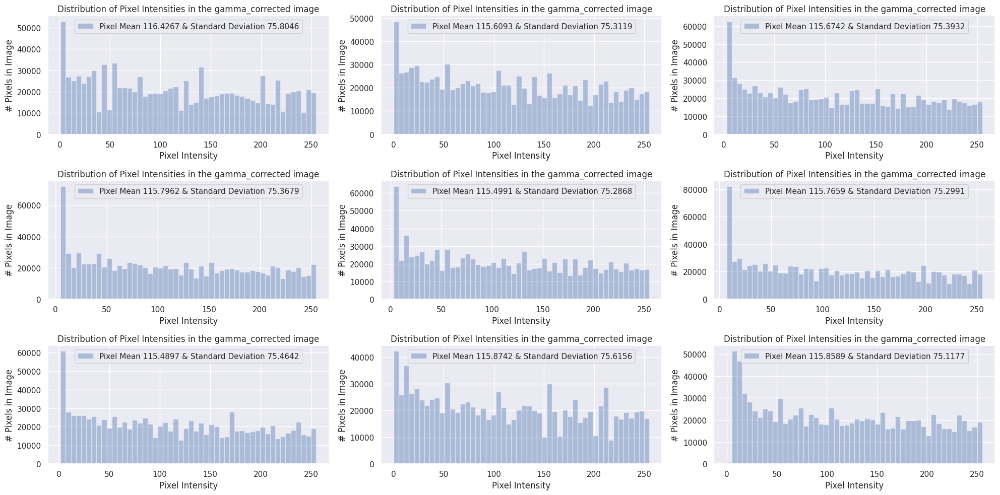

In [ ]:
plt.figure(figsize=(20,10))
for x in range (9):
  plt.subplot(3,3,x+1)
  sns.distplot(gamma_corrected_list[x].ravel(),
             label=f'Pixel Mean {np.mean(gamma_corrected_list[x]):.4f} & Standard Deviation {np.std(gamma_corrected_list[x]):.4f}', kde=False)
  plt.legend(loc='upper center')
  plt.title('Distribution of Pixel Intensities in the gamma_corrected image')
  plt.xlabel('Pixel Intensity')
  plt.ylabel('# Pixels in Image')
plt.tight_layout()

Burada daha önceden 0-1 aralığında histogramını çizdirdiğimiz orjinal imajların , görüntü işleme çözümleri (contrast streching , histogram eşitleme ve gamma düzenlemesi (1.2 ile düzeltme)) geçirmiş halinde ki histogramlarını çizdiriyoruz. Piksel ortalamalarının genelde 115 civarında olduğunu ve grafiğin orjinal histogramlara göre yatayda daha yayılmış olduğunu görüyoruz. Bu da bize görüntü kalitesinin daha artmış olduğunu gösteriyor.  

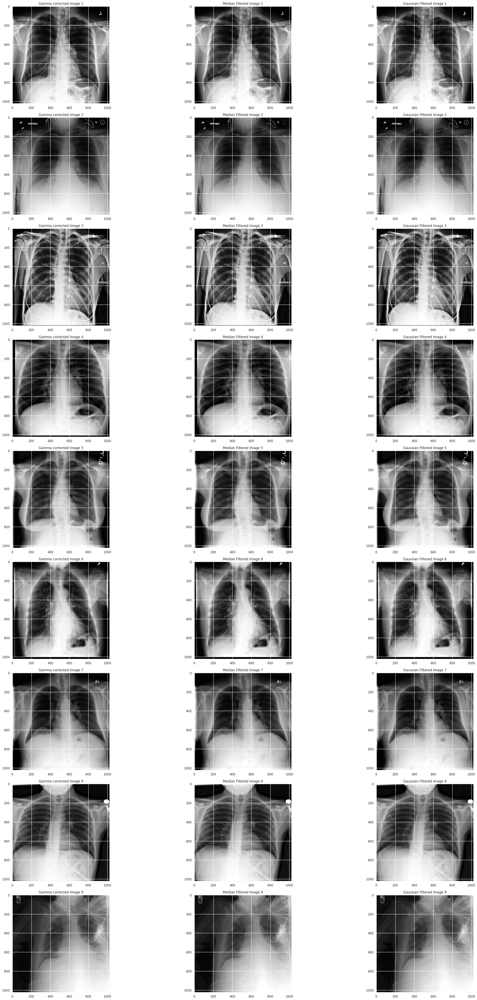

In [ ]:
import cv2  # opencv yüklemesi
median_filtered_list=[]

# burada yine subplot kullanıyoruz.
fig, axes = plt.subplots(9, 3, figsize=(30, 50))
axes = axes.flatten()

for x in range(9):
    # Apply Median Filtering
    median_filtered = cv2.medianBlur(gamma_corrected_list[x], 5)
    median_filtered_list.insert(x,median_filtered) # bu listeyi devam eden kod bloklarında döngü içinde kullanabilmek adına yarattım.

    # Apply Gaussian Blur
    gaussian_filtered = cv2.GaussianBlur(gamma_corrected_list[x], (5, 5), 0)

    axes[3 * x].imshow(gamma_corrected_list[x], cmap='gray')
    axes[3 * x].set_title(f"Gamma corrected Image {x+1}")

    axes[3 * x + 1].imshow(median_filtered, cmap='gray')
    axes[3 * x + 1].set_title(f"Median Filtered Image {x+1}")


    axes[3 * x + 2].imshow(gaussian_filtered, cmap='gray')
    axes[3 * x + 2].set_title(f"Gaussian Filtered Image {x+1}")


plt.tight_layout()
plt.show()

Burada en son gamma düzenlenmesi yapılmış imajlar üzerinde median ve gaussian blurlama işlemleri uygulanıyor. Ben verilen örneğin üzerine gamma düzenlemesi yapılmış hali ile olan imajları da ekledim , süreçler sonrası imajlar arasında ki farkı görebilmek için.

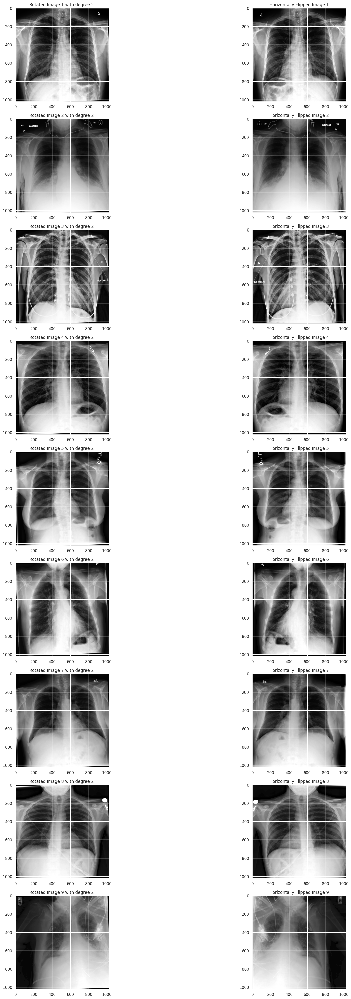

In [ ]:
import random # dereceyi random seçebilmek için random pakedini yüklüyoruz.

angle = random.randint(1,10) # 1 ile 10 arasında random bir integer değeri alıyoruz.

# imajlar için default boyut 24-40 sublot. 9 satır 2 sutun.
fig, axes = plt.subplots(9, 2, figsize=(24, 40))
axes = axes.flatten()
rotated_image_list = []
for x in range(0, 9):
  center = (median_filtered_list[x].shape[1] // 2, median_filtered_list[0].shape[0] // 2)
  rotation_matrix = cv2.getRotationMatrix2D(center, angle, scale=1.0) #açı random üzerinden geldi. Görüntüyü döndürüyoruz.
  rotated_image = cv2.warpAffine(median_filtered_list[x], rotation_matrix, (median_filtered_list[x].shape[1], median_filtered_list[x].shape[0]))
  rotated_image_list.append(rotated_image) # bu listeyi devam eden kod bloklarında döngü içinde kullanabilmek adına yarattım.

  flipped_horizontal = cv2.flip(median_filtered_list[x], 1) # aynaya göre tersine çevirme işlemi

  axes[2*x].imshow(rotated_image, cmap='gray')  # Example: Display the original image
  axes[2*x].set_title(f"Rotated Image {x+1} with degree {angle} ")
  axes[2*x+1].imshow(flipped_horizontal, cmap='gray')  # Example: Display the original image
  axes[2*x+1].set_title(f"Horizontally Flipped Image {x+1}")

plt.tight_layout()
plt.show()


Random kütüphanesi üzerinden 1 ve 10 arasında bir değer alarak görüntümüzü o derece kadar yatırıyoruz. Sonrasında yine elimizde ki görüntüyü aynaya göre tersine çevirme işlemi yapıyoruz. Burada bir görüntü işleme durumu yok , imajda fiziksel hareketlerde bulunuyoruz.

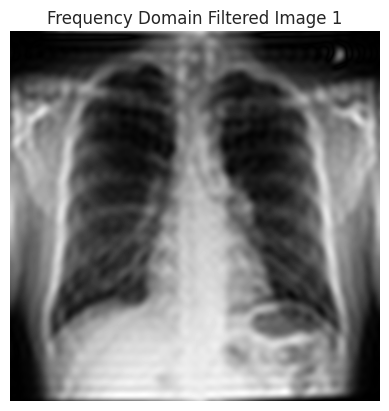

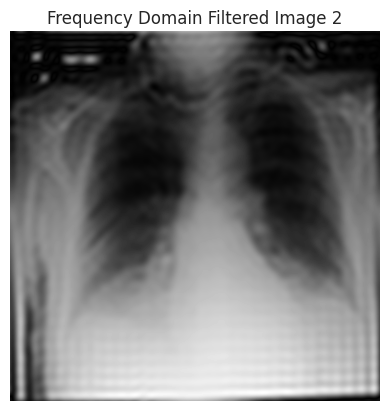

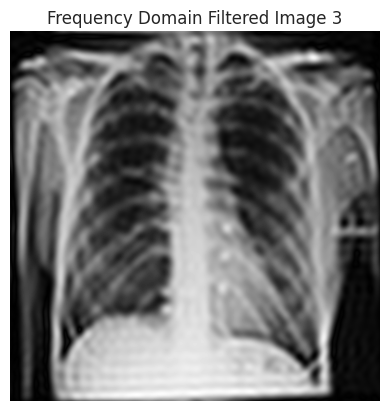

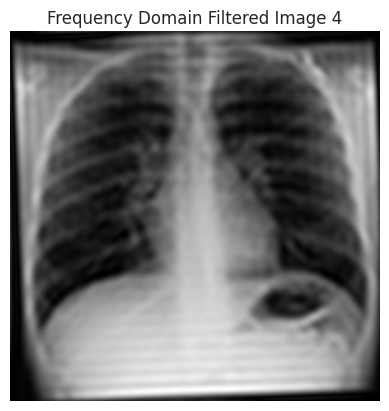

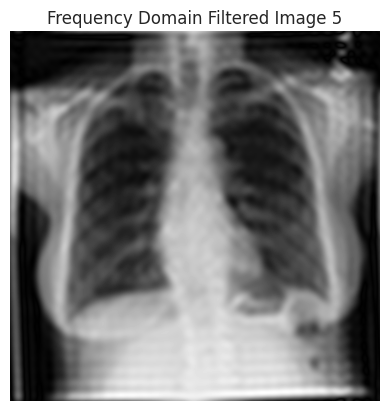

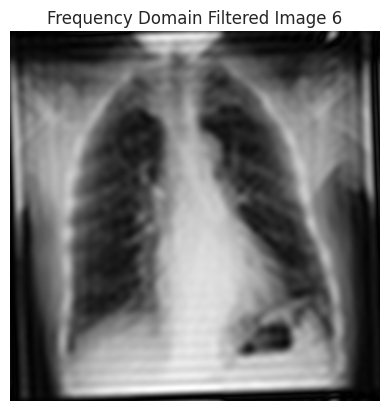

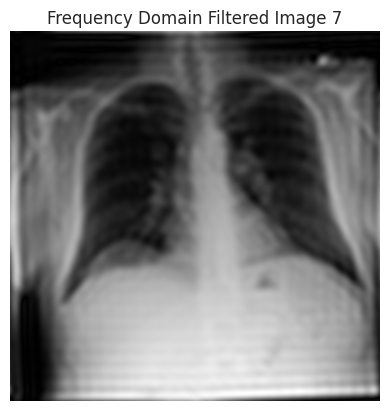

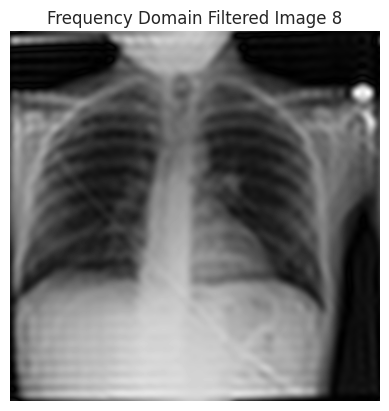

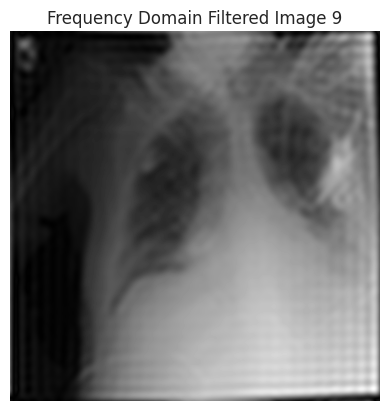

In [ ]:
for x in range(9):
# Rotate edilmiş imajlar için fourier dönüşümü uyguluyoruz.
  dft = cv2.dft(np.float32(rotated_image_list[x]), flags=cv2.DFT_COMPLEX_OUTPUT)
  dft_shifted = np.fft.fftshift(dft)

# Filtreleme maskesini oluşturuyoruz.
  rows, cols = rotated_image_list[x].shape
  crow, ccol = rows // 2 , cols // 2
  mask = np.zeros((rows, cols, 2), np.uint8)
  mask[crow-30:crow+30, ccol-30:ccol+30] = 1

# Maskelemeyi uyguluyoruz.
  fshift = dft_shifted * mask
  f_ishift = np.fft.ifftshift(fshift)
  filtered_image = cv2.idft(f_ishift)
  filtered_image = cv2.magnitude(filtered_image[:, :, 0], filtered_image[:, :, 1])

# Ters fourier dönüşümü ile maske uygulanmış imajı geri çeviriyoruz.
  filtered_image = cv2.normalize(filtered_image, None, 0, 255, cv2.NORM_MINMAX)
  plt.imshow(filtered_image, cmap='gray')
  plt.title(f"Frequency Domain Filtered Image {x+1}")
  plt.axis("off")
  plt.show()

9 imaj için fourier dönüşümü , frekans maskeleme ve ters foruier dönüşümü sonucu çıktıları yazdırıyoruz.

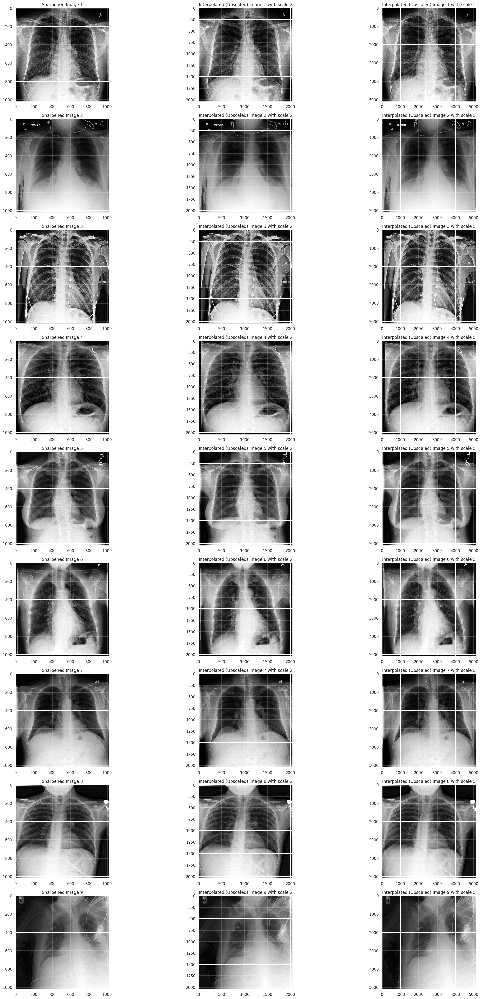

In [ ]:
from scipy.ndimage import zoom
sharpened_image_list = []
upscaled_image_list = []

fig, axes = plt.subplots(9, 3, figsize=(24, 40))
axes = axes.flatten()
for x in range(0, 9):
# Görüntü keskinleştirme
  sharpening_kernel = np.array([[-1, -1, -1],
                              [-1,  9, -1],
                              [-1, -1, -1]])
  sharpened_image = np.clip(cv2.filter2D(gamma_corrected_list[x], -1, sharpening_kernel), 0, 255).astype(np.uint8)
  sharpened_image_list.append(sharpened_image) #listeye atalım.

# Upscaling
  scale_factor = 2
  resized_image = zoom(sharpened_image, scale_factor, order=3)
  upscaled_image_list.append(resized_image) #listeye atalım.

  scale_factor_new = 5 #scale factor nasıl çalışıyor merak ettiğimden 5 olarakta işleme aldım.
  resized_image_new = zoom(sharpened_image, scale_factor_new, order=3)

  axes[3*x].imshow(sharpened_image, cmap='gray')
  axes[3*x].set_title(f"Sharpened Image {x+1}")
  axes[3*x+1].imshow(resized_image, cmap='gray')
  axes[3*x+1].set_title(f"Interpolated (Upscaled) Image {x+1} with scale {scale_factor}")
  axes[3*x+2].imshow(resized_image_new, cmap='gray')
  axes[3*x+2].set_title(f"Interpolated (Upscaled) Image {x+1} with scale {scale_factor_new}")

plt.tight_layout()
plt.show()

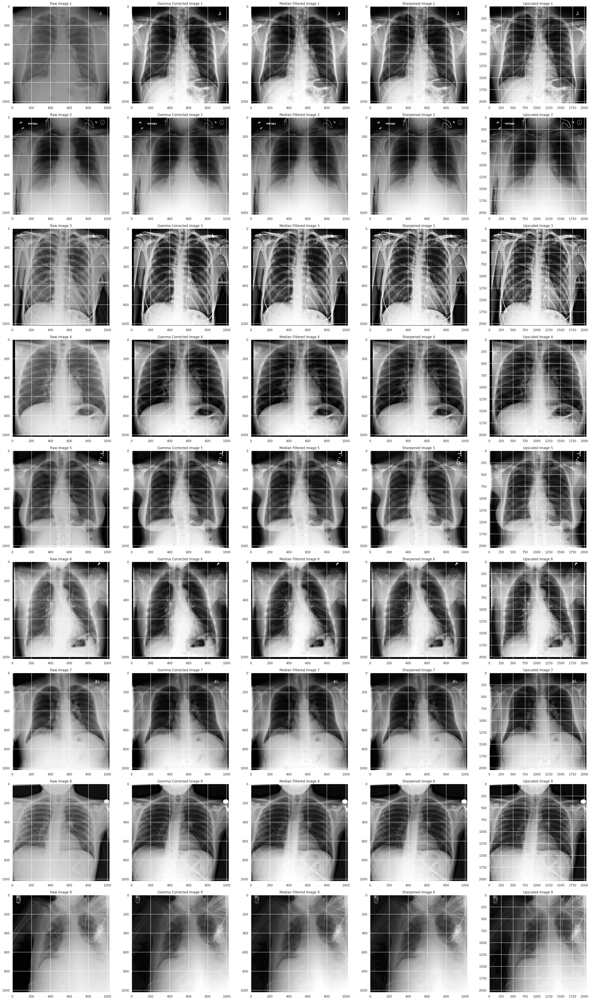

In [ ]:
# Tüm imajların yanyana listelenmesi
fig, axes = plt.subplots(9, 5, figsize=(30, 50))
axes = axes.flatten()

for x in range(9):

    axes[5 * x].imshow(raw_image_list[x], cmap='gray')
    axes[5 * x].set_title(f"Raw Image {x+1}")

    axes[5 * x + 1].imshow(gamma_corrected_list[x], cmap='gray')
    axes[5 * x + 1].set_title(f"Gamma Corrected Image {x+1}")

    axes[5 * x + 2].imshow(median_filtered_list[x], cmap='gray')
    axes[5 * x + 2].set_title(f"Median Filtered Image {x+1}")

    axes[5 * x + 3].imshow(sharpened_image_list[x], cmap='gray')
    axes[5 * x + 3].set_title(f"Sharpened Image {x+1}")

    axes[5 * x + 4].imshow(upscaled_image_list[x], cmap='gray')
    axes[5 * x + 4].set_title(f"Upscaled Image {x+1}")


plt.tight_layout()
plt.show()